In [12]:
import time
import pandas as pd
import json
import numpy as np
from datetime import datetime
from datetime import timezone
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter
from matplotlib.colors import ListedColormap
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import os

# Function

In [13]:
def read_json_from_ros2bag(json_file, print_ = True):
    list_of_length = []
    with open(json_file, 'r') as file:
        json_content = json.load(file)
    if print_:
        print('Read: ',json_file)
    for key, value in json_content.items():
        if print_:
            print(f"{key} range: {len(value)}")
        list_of_length.append(len(value))
    cut_data = {key: value[:min(list_of_length)] for key, value in json_content.items()}
    cut_df = pd.DataFrame(cut_data)
    return cut_df
def read_and_normalize_json_from_ros2bag(json_file, print_=True):
    list_of_length = []
    with open(json_file, 'r') as f:
        data = json.load(f)
    if print_:
        print('Read: ',json_file)
    for key, value in data.items():
        if print_:
            print(f"{key} range: {len(value)}")
        list_of_length.append(len(value))
    # Normalize the data into a DataFrame
    df = pd.json_normalize(data)
    return df

def process_sensor_data(input_df, sensor_key, output_column, window_slide=1, shift=0):
    sensor_val = []
    sensor_ts = []
    sensor_df = []

    for i in range(len(input_df[sensor_key][0])):
        sensor_val.append(input_df[sensor_key][0][i]['val'])
        sensor_ts.append(input_df[sensor_key][0][i]['ts'])

    sensor_df = pd.DataFrame(sensor_val, columns=output_column)
    sensor_df = sensor_df.shift(shift)
    sensor_df = sensor_df.rolling(window=window_slide).mean()
    sensor_df['ts'] = sensor_ts

    return sensor_df

# Load

In [14]:
base_path = "air"

# List only directories
folder_names = [name for name in os.listdir(base_path)
                if os.path.isdir(os.path.join(base_path, name))]
folder_paths = [os.path.join(base_path, name)
                for name in os.listdir(base_path)
                if os.path.isdir(os.path.join(base_path, name))]

air_df_dict = {}

for folder, name in zip(folder_paths,folder_names):
    print(f"Processing folder: {folder}")
    # Read and normalize the JSON data from the ROS2 bag
    df = read_and_normalize_json_from_ros2bag(f'{folder}/{name}_0.db/{name}_0.json', print_ = False)
    air_df_dict[name] = df


Processing folder: air/oaic_air_a0_375_f1_125
Processing folder: air/oaic_air_a0_375_f0_375
Processing folder: air/oaic_air_a0_750_f2_625
Processing folder: air/oaic_air_a0_500_f1_125
Processing folder: air/oaic_air_a0_500_f0_375
Processing folder: air/oaic_air_a0_125_f2_625
Processing folder: air/oaic_air_a0_875_f0_375
Processing folder: air/oaic_air_a0_875_f1_125
Processing folder: air/oaic_air_a1_000_f0_750
Processing folder: air/oaic_air_a1_000_f1_500
Processing folder: air/oaic_air_a0_750_f1_500
Processing folder: air/oaic_air_a0_750_f0_750
Processing folder: air/oaic_air_a0_625_f1_125
Processing folder: air/oaic_air_a0_125_f1_500
Processing folder: air/oaic_air_a0_125_f0_750
Processing folder: air/oaic_air_a0_625_f0_375
Processing folder: air/oaic_air_a0_250_f2_250
Processing folder: air/oaic_air_a0_250_f3_000
Processing folder: air/oaic_air_a1_000_f2_625
Processing folder: air/oaic_air_a0_750_f1_125
Processing folder: air/oaic_air_a0_750_f0_375
Processing folder: air/oaic_air_a0

In [15]:
base_path = "water"

# List only directories
folder_names = [name for name in os.listdir(base_path)
                if os.path.isdir(os.path.join(base_path, name))]
folder_paths = [os.path.join(base_path, name)
                for name in os.listdir(base_path)
                if os.path.isdir(os.path.join(base_path, name))]

water_df_dict = {}

for folder, name in zip(folder_paths,folder_names):
    print(f"Processing folder: {name}")
    # Read and normalize the JSON data from the ROS2 bag
    df = read_and_normalize_json_from_ros2bag(f'{folder}/{name}_0.db/{name}_0.json', print_ = False)
    water_df_dict[name] = df


Processing folder: oaic_water_a1_000_f3_000
Processing folder: oaic_water_a1_000_f2_250
Processing folder: oaic_water_a0_250_f1_500
Processing folder: oaic_water_a0_250_f0_750
Processing folder: oaic_water_a0_750_f2_250
Processing folder: oaic_water_a0_750_f3_000
Processing folder: oaic_water_a0_500_f2_250
Processing folder: oaic_water_a0_500_f3_000
Processing folder: oaic_water_a0_500_f1_500
Processing folder: oaic_water_a0_500_f0_750
Processing folder: oaic_water_a1_000_f0_750
Processing folder: oaic_water_a1_000_f1_500
Processing folder: oaic_water_a0_250_f2_250
Processing folder: oaic_water_a0_250_f3_000
Processing folder: oaic_water_a0_750_f1_500
Processing folder: oaic_water_a0_750_f0_750


# Mask files

In [16]:
filtered_water_df_dict = water_df_dict

# Extract the last 12 chars of each water key
water_keys_tail = {k[-12:] for k in water_df_dict}

filtered_air_df_dict = {
    k: v for k, v in air_df_dict.items() if k[-12:] in water_keys_tail
}

print(f"✅ Filtered air dict: {len(filtered_air_df_dict)} items")
print(f"✅ Filtered water dict: {len(filtered_water_df_dict)} items")

✅ Filtered air dict: 16 items
✅ Filtered water dict: 16 items


# Process

In [17]:


def sort_key(name):
    # Extract the part like a0_250_f1_500
    parts = name.split('_')
    a = int(parts[-4][1:])      # 'a0' -> 0
    x = int(parts[-3])          # '250'
    f = int(parts[-2][1:])      # 'f1' -> 1
    y = int(parts[-1])          # '500'
    return (a, x, f, y)

sorted_air_df_dict = dict(sorted(filtered_air_df_dict.items(), key=lambda item: sort_key(item[0])))
sorted_water_df_dict = dict(sorted(filtered_water_df_dict.items(), key=lambda item: sort_key(item[0])))

# print(sorted_air_df_dict.keys())
# print(sorted_water_df_dict.keys())


def format_title(key: str) -> str:
    # Extract the a and f values using split
    key = key[11:]  
    try:
        a_part = key.split('_')[0][-1] + '.' + key.split('_')[1]
        f_part = key.split('_')[2][-1] + '.' + key.split('_')[3]
        return f'a={a_part} rad, f={f_part} hz'
    except IndexError:
        return key  # Fallback if unexpected format
# print(format_title('oaic_water_a0_250_f0_750'))  # Example usage

In [41]:
processed_water_df_dict = {}
processed_air_df_dict = {}

topics = ['JointAngles', 'JointVelocities', 'JointDamping', 'JointStiffness', 'JointCommands']

for key in sorted_water_df_dict:
    processed_water_df_dict[key] = {}  # Initialize inner dict
    for topic in topics:
        processed_water_df_dict[key][topic] = process_sensor_data(sorted_water_df_dict [key], topic, ['M1'], window_slide=10, shift=0)

for key in sorted_air_df_dict:
    processed_air_df_dict[key] = {}  # Initialize inner dict
    for topic in topics:
        processed_air_df_dict[key][topic] = process_sensor_data(sorted_air_df_dict [key], topic, ['M1'], window_slide=10, shift=0)



# Plot Analysis

In [19]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with subplots
fig = make_subplots(rows=4, cols=4, vertical_spacing=0.01, shared_xaxes=True, shared_yaxes=False)

colors = {
    'water': 'blue',
    'air': 'red',
}

i = 1
j = 1
for key in processed_water_df_dict:
    fig.add_trace(
        go.Scatter(
            x=processed_water_df_dict[key]['JointAngles']['ts'],
            y=processed_water_df_dict[key]['JointAngles']['M1'],
            name=f'q [{key[-19:]}]',
            # line=dict(color=colors['water'])
        ),
        row=i, col=j
    )
    j += 1

    if j > 4:
        j = 1
        i += 1

i = 1
j = 1
for key in processed_air_df_dict:
    fig.add_trace(
        go.Scatter(
            x=processed_air_df_dict[key]['JointAngles']['ts'],
            y=processed_air_df_dict[key]['JointAngles']['M1'],
            name=f'q [{key[-19:]}]',
            # line=dict(color=colors['air'])
        ),
        row=i, col=j
    )
    j += 1

    if j > 4:
        j = 1
        i += 1



fig.update_layout(
    height=900,
    width=1200,
    font=dict(size=13),
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

fig.update_xaxes(range=[5, 15])

fig.show()




In [20]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with subplots
fig = make_subplots(rows=4, cols=4, vertical_spacing=0.01, shared_xaxes=True, shared_yaxes=False)

colors = {
    'water': 'blue',
    'air': 'red',
}

i = 1
j = 1
for key in processed_water_df_dict:
    fig.add_trace(
        go.Scatter(
            x=processed_water_df_dict[key]['JointDamping']['ts'],
            y=processed_water_df_dict[key]['JointDamping']['M1'],
            name=f'D [{key[-19:]}]',
            # line=dict(color=colors['water'])
        ),
        row=i, col=j
    )
    j += 1

    if j > 4:
        j = 1
        i += 1

i = 1
j = 1
for key in processed_air_df_dict:
    fig.add_trace(
        go.Scatter(
            x=processed_air_df_dict[key]['JointDamping']['ts'],
            y=processed_air_df_dict[key]['JointDamping']['M1'],
            name=f'D [{key[-19:]}]',
            # line=dict(color=colors['air'])
        ),
        row=i, col=j
    )
    j += 1

    if j > 4:
        j = 1
        i += 1



fig.update_layout(
    height=900,
    width=1200,
    font=dict(size=13),
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

# fig.update_yaxes(range=[-0.3, 0.8])
fig.update_xaxes(range=[5, 6])

fig.show()




# Plot Save

/var/folders/y0/1h3ym27s7_b245560wdhwl_m0000gn/T/ipykernel_35770/2897257592.py:65: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



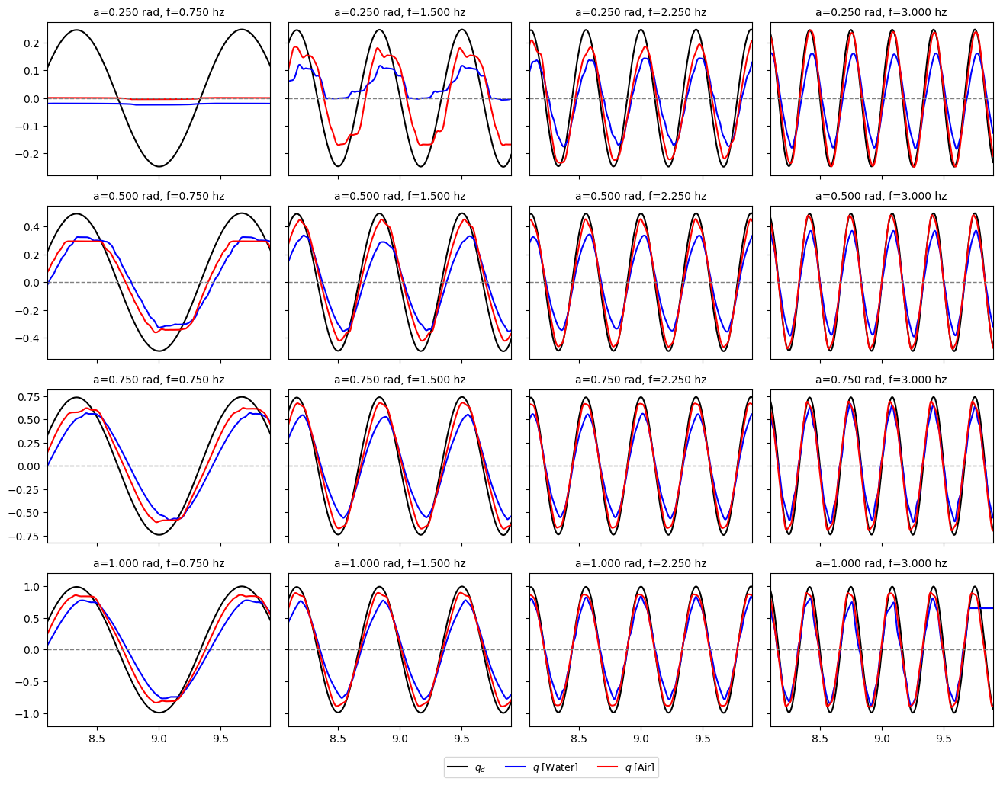

In [61]:

colors = {
    'water': 'blue',
    'air': 'red',
}

fig, axes = plt.subplots(4, 4, figsize=(16, 12), sharex=True, sharey='row', gridspec_kw={'wspace':0.08, 'hspace':0.2})

# Flatten axes for easy indexing
axes = axes.flatten()


for idx, key in enumerate(processed_water_df_dict):
    if idx >= 16: break  # Ensure we don't go out of subplot bounds

    ax = axes[idx]
    ts = np.array(processed_water_df_dict[key]['JointCommands']['ts'])
    M1 = np.array(processed_water_df_dict[key]['JointCommands']['M1'])

    ax.plot(ts, M1, label=r'$q_d$ ', color='black')

    ax.set_title(format_title(key), fontsize=10, y=1)


# Plot water data
for idx, key in enumerate(processed_water_df_dict):
    if idx >= 16: break  # Ensure we don't go out of subplot bounds

    ax = axes[idx]
    ts = np.array(processed_water_df_dict[key]['JointAngles']['ts'])
    M1 = np.array(processed_water_df_dict[key]['JointAngles']['M1'])

    ax.plot(ts, M1, label=r'$q$ [Water]', color=colors['water'])

    ax.set_title(format_title(key), fontsize=10, y=1)



# Plot air data
for idx, key in enumerate(processed_air_df_dict):
    if idx >= 16: break

    ax = axes[idx]
    ts = np.array(processed_air_df_dict[key]['JointAngles']['ts'])
    M1 = np.array(processed_air_df_dict[key]['JointAngles']['M1'])

    ax.plot(ts, M1, label=r'$q$ [Air]', color=colors['air'])

axes[15].set_ylim(-1.2, 1.2)

# General styling
for ax in axes:
    ax.tick_params(labelsize=10)
    ax.axhline(y=0, color='gray', linestyle='--', linewidth=1)
    ax.set_xlim(8.1, 9.9)


axes[15].legend(fontsize=9, 
            loc='upper right',
            ncol=3,
            bbox_to_anchor=(-0.5, -0.2),  # Slightly outside the plot
            borderaxespad=0.
            )


fig.tight_layout()
plt.show()


/var/folders/y0/1h3ym27s7_b245560wdhwl_m0000gn/T/ipykernel_35770/306454619.py:54: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



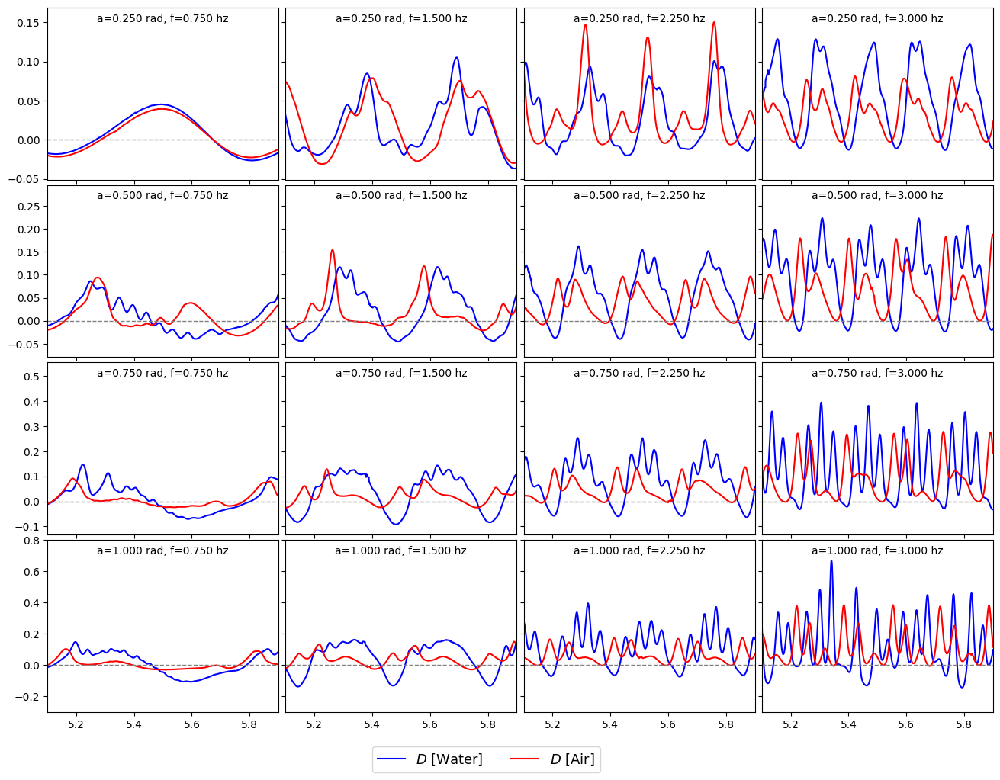

In [57]:

colors = {
    'water': 'blue',
    'air': 'red',
}

fig, axes = plt.subplots(4, 4, figsize=(16, 12), sharex=True, sharey='row', gridspec_kw={'wspace':0.03, 'hspace':0.03})

# Flatten axes for easy indexing
axes = axes.flatten()



# Plot water data
for idx, key in enumerate(processed_water_df_dict):
    if idx >= 16: break  # Ensure we don't go out of subplot bounds

    ax = axes[idx]
    ts = np.array(processed_water_df_dict[key]['JointDamping']['ts'])
    M1 = np.array(processed_water_df_dict[key]['JointDamping']['M1'])

    ax.plot(ts, M1, label=r'$D$ [Water]', color=colors['water'])

    ax.set_title(format_title(key), fontsize=10, y=0.88)



# Plot air data
for idx, key in enumerate(processed_air_df_dict):
    if idx >= 16: break

    ax = axes[idx]
    ts = np.array(processed_air_df_dict[key]['JointDamping']['ts'])
    M1 = np.array(processed_air_df_dict[key]['JointDamping']['M1'])

    ax.plot(ts, M1, label=r'$D$ [Air]', color=colors['air'])

axes[15].set_ylim(-0.3,0.8)

# General styling
for ax in axes:
    ax.tick_params(labelsize=10)
    ax.axhline(y=0, color='gray', linestyle='--', linewidth=1)
    ax.set_xlim(5.1, 5.9)


axes[15].legend(fontsize=13, 
            loc='upper right',
            ncol=2,
            bbox_to_anchor=(-.7, -0.2),  # Slightly outside the plot
            borderaxespad=0.
            )


fig.tight_layout()
plt.show()


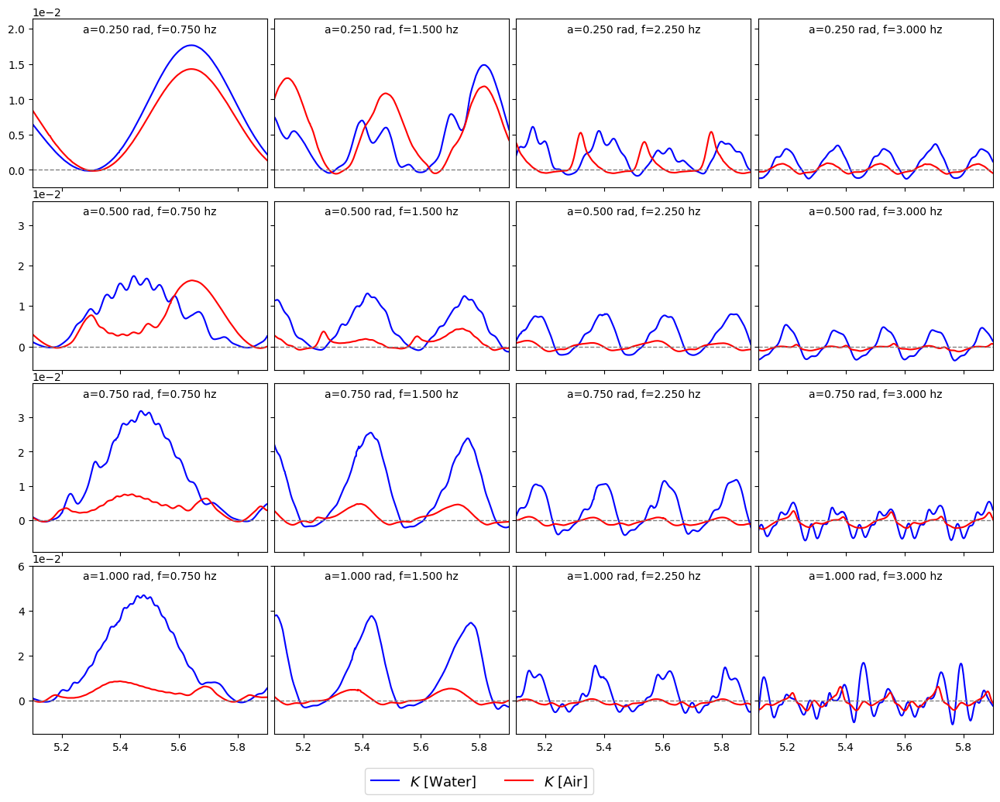

In [60]:

colors = {
    'water': 'blue',
    'air': 'red',
}

fig, axes = plt.subplots(4, 4, figsize=(16, 12), sharex=True, sharey='row', gridspec_kw={'wspace':0.03, 'hspace':0.08})

# Flatten axes for easy indexing
axes = axes.flatten()



# Plot water data
for idx, key in enumerate(processed_water_df_dict):
    if idx >= 16: break  # Ensure we don't go out of subplot bounds

    ax = axes[idx]
    ts = np.array(processed_water_df_dict[key]['JointStiffness']['ts'])
    M1 = np.array(processed_water_df_dict[key]['JointStiffness']['M1'])

    ax.plot(ts, M1, label=r'$K$ [Water]', color=colors['water'])

    ax.set_title(format_title(key), fontsize=10, y=0.88)



# Plot air data
for idx, key in enumerate(processed_air_df_dict):
    if idx >= 16: break

    ax = axes[idx]
    ts = np.array(processed_air_df_dict[key]['JointStiffness']['ts'])
    M1 = np.array(processed_air_df_dict[key]['JointStiffness']['M1'])

    ax.plot(ts, M1, label=r'$K$ [Air]', color=colors['air'])

axes[15].set_ylim(-0.015, 0.06)

# General styling
for ax in axes:
    ax.tick_params(labelsize=10)
    ax.axhline(y=0, color='gray', linestyle='--', linewidth=1)
    ax.ticklabel_format(style='sci', axis='y', scilimits=(-2, 2))
    ax.set_xlim(5.1, 5.9)
    
axes[15].legend(fontsize=13, 
            loc='upper right',
            ncol=2,
            bbox_to_anchor=(-.7, -0.2),  # Slightly outside the plot
            borderaxespad=0.
            )

